In [1]:
# Ejercicios de análisis geoespacial,
# pasados de R a python.

import os

import rioxarray
import string

import numpy as np
import pandas as pd
import xarray as xr
import geoviews as gv
import geopandas as gpd
#import rasterio.features as riof

from scipy import stats

from matplotlib import pyplot as plt

In [2]:
path = "../../datos/Tablas_bio/"
fname = ["datos_especies_islas.csv",
    "areas_islas.csv", "distancias.csv",
    "areas_nichos.csv"]

especies = pd.read_csv(path + fname[0], index_col = 0)
areas = pd.read_csv(path + fname[1], index_col = 0)
distancias = pd.read_csv(path + fname[2], index_col = 0)
datos = pd.read_csv(path + fname[3], index_col = 0)

# Se unen los DataFrame de acuerdo a la columna deseada.
df = pd.merge(pd.merge(especies, areas, on = "Islands"),
    distancias, on = "species")

Text(0.5, 1.0, 'Histograma de Homolechis - Distancias')

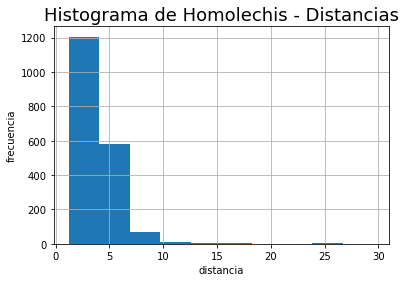

In [3]:
# Se grafica un histograma.

homo = df.loc[df["species"] == "homolechis",
    "distancias"].astype(float)

homo.hist()

plt.xlabel("distancia")
plt.ylabel("frecuencia")
plt.title("Histograma de Homolechis - Distancias",
    fontsize = 18)

In [4]:
# Estadísticos.

print("Mean: " + f"{homo.mean():06.3f}")
print("Min:  " + f"{homo.min():06.3f}")
print("Max:  " + f"{homo.max():06.3f}")
print("Std:  " + f"{homo.std():06.3f}")
print("Var:  " + f"{homo.var():06.3f}")

Mean: 03.917
Min:  01.233
Max:  29.516
Std:  01.910
Var:  03.646


Text(0.5, 1.0, 'Histograma de Homolechis - log(Dist)')

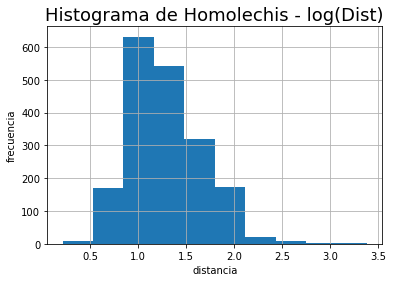

In [5]:
# Histograma con datos transformados.

log_homo = np.log(homo)

log_homo.hist()

plt.xlabel("distancia")
plt.ylabel("frecuencia")
plt.title("Histograma de Homolechis - log(Dist)",
    fontsize = 18)

<AxesSubplot:xlabel='nicho', ylabel='area'>

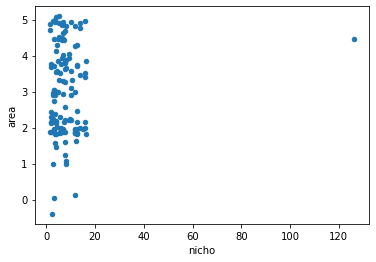

In [6]:
# Gráfica de dispersión.

datos.plot.scatter("nicho", "area")

Text(0.5, 1.0, 'Residuales de la regresión')

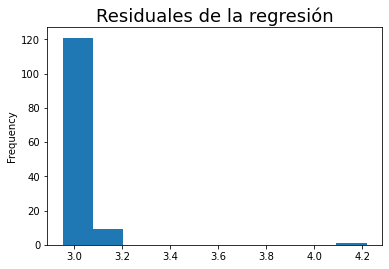

In [7]:
# Regresión lineal.

slope, intercept, r_value, p_value, std_err = ( stats
    .linregress(datos["nicho"], datos["area"]) )

datos["reg"] = intercept + slope * datos["nicho"]

datos["reg"].plot.hist()

plt.title("Residuales de la regresión",
    fontsize = 18)

Text(0.5, 1.0, 'Regresión')

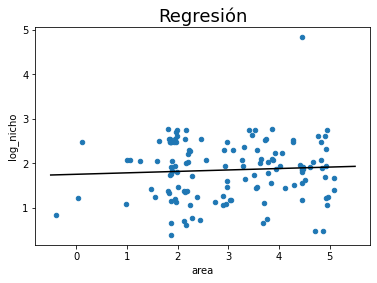

In [8]:
# Regresión lineal con datos transformados.

datos["log_nicho"] = np.log(datos["nicho"])

datos.plot.scatter("area", "log_nicho")

slope, intercept, r_value, p_value, std_err = ( stats
    .linregress(datos["area"], datos["log_nicho"]) )

plt.plot(np.arange(-0.5, 6),
    intercept + slope * np.arange(-0.5, 6), color = "black")
plt.title("Regresión", fontsize = 18)


Text(0.5, 1.0, 'Regresión')

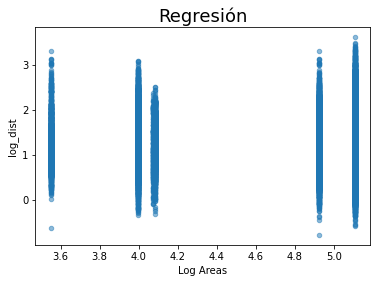

In [9]:
# Dispersión de una mayor cantidad de datos.


# Coerce forza a que los datos erróneos se conviertan en np.nan.
df["distancias"] = pd.to_numeric(df["distancias"],
    errors = "coerce")
df["Log Areas"] = pd.to_numeric(df["Log Areas"],
    errors = "coerce")

df["log_dist"] = np.log(df["distancias"].astype(float))

df.plot.scatter("Log Areas", "log_dist", alpha = 0.5)

plt.title("Regresión", fontsize = 18)

In [10]:
# Se carga el motor gráfico de Geoviews.

gv.extension("matplotlib")
gv.output(size = 150)

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

In [11]:
lon = [-116.7, -120.4, -116.7, -113.5, -115.5,
-120.8, -119.5, -113.7, -113.7, -110.7]
lat = [45.3, 42.6, 38.9, 42.1, 35.7, 38.9,
36.2, 39, 41.6, 36.9]

# Se arman los pares de coordenadas.
coords = np.array(list(zip(lon, lat)))

points = []

# Se crea una cadena wkt de cada punto.
for i, value in enumerate(coords):
    points.append("POINT("
        + str(value[0]) + " " + str(value[1]) + ")")

In [12]:
# Se crean valores aleatorios de precipitación.
np.random.seed(0)
pre = ( np.random.normal(size = coords.shape[0]) * 10 ) ** 3

# Se crea un GeoDataFrame con geometría a partir del wkt.
df_pre = pd.DataFrame({"geometry": points,
    "precipitation": pre})
df_pre["geometry"] = ( gpd.GeoSeries
    .from_wkt(df_pre["geometry"]) )  
gdf_pre = gpd.GeoDataFrame(
    df_pre, geometry = df_pre.geometry, crs = "epsg:4326")

C:\Users\Rodrigo\anaconda3\envs\gv2\lib\site-packages\matplotlib\collections.py:1003: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor
C:\Users\Rodrigo\anaconda3\envs\gv2\lib\site-packages\matplotlib\collections.py:1003: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor


:Overlay
   .Points.I  :Points   [Longitude,Latitude]   (precipitation)
   .Text.I    :Text   [x,y]
   .Text.II   :Text   [x,y]
   .Text.III  :Text   [x,y]
   .Text.IV   :Text   [x,y]
   .Text.V    :Text   [x,y]
   .Text.VI   :Text   [x,y]
   .Text.VII  :Text   [x,y]
   .Text.VIII :Text   [x,y]
   .Text.IX   :Text   [x,y]
   .Text.X    :Text   [x,y]
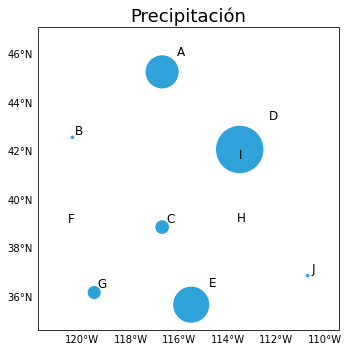

In [13]:
# Se crean los valores de las etiquetas.
letters = [x for x in string.ascii_uppercase[0:10]]

# Espaciado de las etiquetas.
gdf_pre["pad"] = np.absolute(gdf_pre["precipitation"]) / 10000 + 0.25

# Se crean las etiquetas.
labels = [ gv.Text(coords[x, 0] + gdf_pre["pad"][x],
    coords[x, 1] + gdf_pre["pad"][x], letters[x]) 
    for x in range(len(letters))]

# El tamaño de los puntos es proporcional a su valor.
opts = {"s": gv.dim("precipitation") / 5,
    "show_legend": True}

# Se crea la grafica con los puntos.
graph = ( gv.Points(gdf_pre, 
    vdims = "precipitation").opts(**opts) )

# Se grafican las etiquetas.
for value in labels:
    graph *= value

graph.opts(title = "Precipitación",
    fontsize = 18)

In [14]:
# Se arman los pares de coordenadas.
lon = [-116.7, -120.4, -116.7, -113.5, -115.5,
    -120.8, -119.5, -113.7, -113.7, -110.7]
lat = [45.3, 42.6, 38.9, 42.1, 35.7,
    38.9, 36.2, 39, 41.6, 36.9]
coords = np.array(list(zip(lon, lat)))

# Se crea una cadena wkt de cada punto.
points = []
for i, value in enumerate(coords):
    points.append("POINT("
        + str(value[0]) + " " + str(value[1]) + ")")

# Se arman los pares de coordenadas.
lon = [-116.8, -114.2, -112.9, -111.9, -114.2, -115.4, -117.7]
lat = [41.3, 42.9, 42.4, 39.8, 37.6, 38.3, 37.6]
coords = np.array(list(zip(lon, lat)))

# Se crea una cadena wkt para la línea y el polígono.
path = "LINESTRING("
polygon = "POLYGON(("
for i, value in enumerate(coords):
    path += str(value[0]) + " " + str(value[1]) + ","
    polygon += str(value[0]) + " " + str(value[1]) + ","
polygon += ( str(coords[0, 0]) +
    " " + str(coords[0, 1]) + "," )
path = path[:-1] + ")"
polygon = polygon[:-1] + "))"

geometries = points + [path, polygon]

In [15]:
# Se crea un GeoDataFrame con geometría a partir del wkt.
df = pd.DataFrame({"geometry": geometries})
df["geometry"] = ( gpd.GeoSeries
    .from_wkt(df["geometry"]) )
gdf = gpd.GeoDataFrame(
    df, geometry = df.geometry, crs = "epsg:4326")

In [16]:
gdf

,geometry
0,POINT (-116.70000 45.30000)
1,POINT (-120.40000 42.60000)
2,POINT (-116.70000 38.90000)
3,POINT (-113.50000 42.10000)
4,POINT (-115.50000 35.70000)
5,POINT (-120.80000 38.90000)
6,POINT (-119.50000 36.20000)
7,POINT (-113.70000 39.00000)
8,POINT (-113.70000 41.60000)
9,POINT (-110.70000 36.90000)


:Path   [Longitude,Latitude]
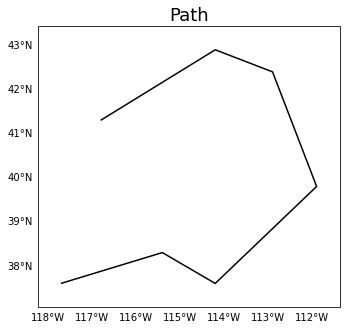

In [17]:
# Se grafica la linea

( gv.Path(gdf.iat[gdf.shape[0] - 2, 0]) 
    .opts(color = "black", title = "Path",
    fontsize = 18) )

:Overlay
   .Polygons.I :Polygons   [Longitude,Latitude]
   .Points.I   :Points   [Longitude,Latitude]
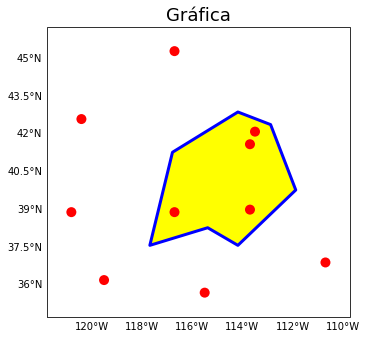

In [18]:
# Se crean las gráficas.

gv_points = ( gv.Points(gdf.loc[0:9])
    .opts(color = "red", s = 100) )

gv_polygons = ( gv.Polygons(gdf.iat[gdf.shape[0] - 1, 0])
    .opts(edgecolor = "blue",
    facecolor = "yellow", linewidth = 3) )

(gv_polygons * gv_points).opts(title = "Gráfica", fontsize = 18)

In [3]:
path = "../../datos/"

files = ["Bioclimaticos/" + x for x
    in os.listdir(path + "Bioclimaticos/")]

# Se cargan todos los geoTIFFs.
rasters = [xr.open_rasterio(path + x) for x in files]

kdims = ["x", "y"]
vdims = []

# Se asigna el nombre de cada variable.
for i, value in enumerate(rasters):
    rasters[i] = value.assign_coords(
        band = ["bio_" + f"{i + 1:02d}"])
    vdims.append("bio_" + f"{i + 1:02d}")

# Se concatenan los rasters y se establecen
# los valores np.nan.
ds = ( xr.concat(rasters, dim = "band")
    .to_dataset(dim = "band"))
ds = ds.where(ds > -3e+38, np.nan)

ds

<xarray.Dataset>
Dimensions:  (y: 180, x: 360)
Coordinates:
  * y        (y) float64 89.5 88.5 87.5 86.5 85.5 ... -86.5 -87.5 -88.5 -89.5
  * x        (x) float64 -179.5 -178.5 -177.5 -176.5 ... 176.5 177.5 178.5 179.5
Data variables: (12/19)
    bio_01   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    bio_02   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    bio_03   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    bio_04   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    bio_05   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    bio_06   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    ...       ...
    bio_14   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    bio_15   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    bio_16   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    bio_17   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    bio_18   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
    bio_19   (y, x) float32 nan nan nan nan nan nan ... nan nan nan nan nan nan
Attributes:
    transform:   (1.0, 0.0, -180.0, 0.0, -1.0, 90.0)
    res:         (1.0, 1.0)
    is_tiled:    0
    nodatavals:  (-3.4e+38,)
    scales:      (1.0,)
    offsets:     (0.0,)

:Image   [x,y]   (bio_01)
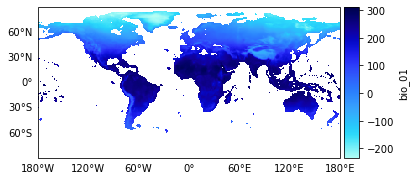

In [20]:
# Se grafica la primera variable.

ds_gv = gv.Dataset(ds, kdims = kdims, vdims = vdims[0])

ds_gv.to(gv.Image, kdims).opts(colorbar = True)

In [21]:
# Opción para hacer una máscara raster.
# No recorta la zona en cuestión.

#fname = "Shapefile/cont_america.shp"

#gdf = gpd.read_file(path + fname)

#mask = riof.geometry_mask(
#    gdf[gdf["PAÍS"] == "México"].geometry,
#    out_shape = (len(ds.y), len(ds.x)),
#    transform = ds.transform,
#    invert = True)
#mask = xr.DataArray(mask , dims=("y", "x"))

# Then apply the mask
#clip = ds.where(mask == True)

In [4]:
fname = "Shapefile/cont_america.shp"

gdf = gpd.read_file(path + fname)

# Se obtiene el contorno de los países.
gdf["boundary"] = gdf.boundary

# Se selecciona México.
cuenca = ( gv.Path(gdf[gdf["PAÍS"] == "México"])
    .opts(color = "black") )

In [7]:
(gdf[gdf["PAÍS"] == "México"].
    geometry.bounds.to_numpy()[0])

array([-117.12695313,   14.55054665,  -86.73861694,   32.71845627])

In [23]:
# Se establece el datum de los datos.
ds = ds.rio.write_crs(gdf.crs)

# Se recorta el DataSet a la región de México.
clip = ds.rio.clip_box(
    *gdf[gdf["PAÍS"] == "México"].
    geometry.bounds.to_numpy()[0])

# Se hace la máscara de México.
clip = clip.rio.clip(gdf[gdf["PAÍS"] == "México"].geometry,
    gdf.crs, drop=False, invert=False)

:Overlay
   .Image.I :Image   [x,y]   (bio_01)
   .Path.I  :Path   [Longitude,Latitude]   (PAÍS)
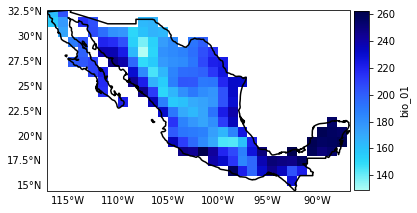

In [24]:
#Se gráfica el raster con máscara y el contorno de México.

clip_gv = gv.Dataset(clip, kdims = kdims, vdims = vdims[0])

clip_img = clip_gv.to(gv.Image, kdims).opts(colorbar = True)

clip_img * cuenca